### Thêm thư viện

In [ ]:
import numpy as np
from scipy import signal, ndimage
from skimage import filters, feature, img_as_float
from skimage.io import imread
from skimage.color import rgb2gray
from PIL import Image
import matplotlib.pylab as pylab

In [83]:
def plot_image(image, title):
    pylab.imshow(image)
    pylab.title(title, size=20)
    pylab.axis('off')

### Đạo hàm và gradients

C:\Users\Admin\AppData\Local\Temp\ipykernel_6484\2831359197.py:12: RuntimeWarning: divide by zero encountered in divide
  im_dir = np.arctan(im_y/im_x)
C:\Users\Admin\AppData\Local\Temp\ipykernel_6484\2831359197.py:12: RuntimeWarning: invalid value encountered in divide
  im_dir = np.arctan(im_y/im_x)


<Figure size 640x480 with 0 Axes>

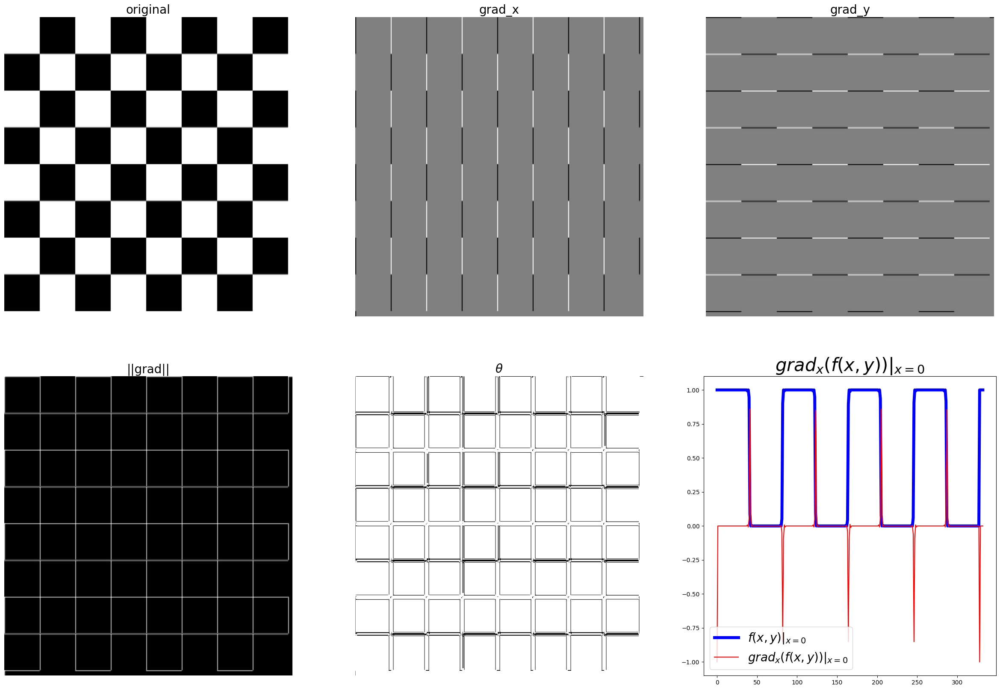

In [84]:
ker_x = [[-1, 1]]
ker_y = [[-1], [1]]
# Đọc ảnh và loại bỏ kênh alpha nếu có
im = imread('../images/chess.png')
if im.shape[-1] == 4:  # Kiểm tra xem có kênh alpha hay không
    im = im[..., :3]  # Giữ lại 3 kênh RGB
# Chuyển ảnh sang thang độ xám
im = rgb2gray(im)
im_x = signal.convolve2d(im, ker_x, mode='same')
im_y = signal.convolve2d(im, ker_y, mode='same')
im_mag = np.sqrt(im_x**2 + im_y**2)
im_dir = np.arctan(im_y/im_x)
pylab.gray()
pylab.figure(figsize=(30,20))
pylab.subplot(231), plot_image(im, 'original'), pylab.subplot(232),
plot_image(im_x, 'grad_x')
pylab.subplot(233), plot_image(im_y, 'grad_y'), pylab.subplot(234),
plot_image(im_mag, '||grad||')
pylab.subplot(235), plot_image(im_dir, r'$\theta$'), pylab.subplot(236)
pylab.plot(range(im.shape[1]), im[0,:], 'b-', label=r'$f(x,y)|_{x=0}$', linewidth=5)
pylab.plot(range(im.shape[1]), im_x[0,:], 'r-', label=r'$grad_x (f(x,y))|_{x=0}$')
pylab.title(r'$grad_x (f(x,y))|_{x=0}$', size=30)
pylab.legend(prop={'size': 20})
pylab.show()

### Laplacian

<Figure size 640x480 with 0 Axes>

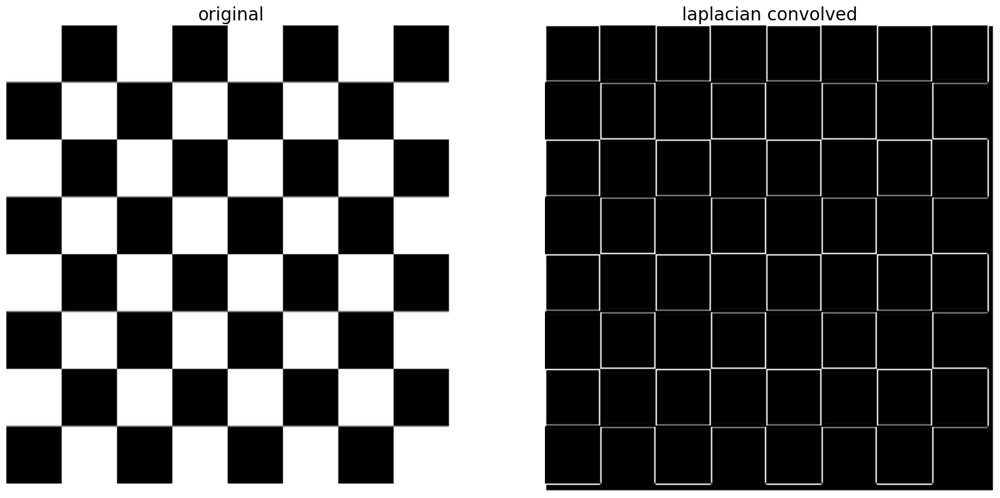

In [85]:
ker_laplacian = [[0,-1,0],[-1, 4, -1],[0,-1,0]]
# Đọc ảnh và loại bỏ kênh alpha nếu có
im = imread('../images/chess.png')
if im.shape[-1] == 4:  # Kiểm tra xem có kênh alpha hay không
    im = im[..., :3]  # Giữ lại 3 kênh RGB

# Chuyển ảnh sang thang độ xám
im = rgb2gray(im)
im1 = np.clip(signal.convolve2d(im, ker_laplacian, mode='same'),0,1)
pylab.gray()
pylab.figure(figsize=(20,10))
pylab.subplot(121), plot_image(im, 'original')
pylab.subplot(122), plot_image(im1, 'laplacian convolved')
pylab.show()

### Ảnh hưởng của nhiễu đối với phép tính gradient

C:\Users\Admin\AppData\Local\Temp\ipykernel_6484\3418324632.py:21: RuntimeWarning: divide by zero encountered in divide
  im_ang = np.arctan(im_y/im_x)


<Figure size 640x480 with 0 Axes>

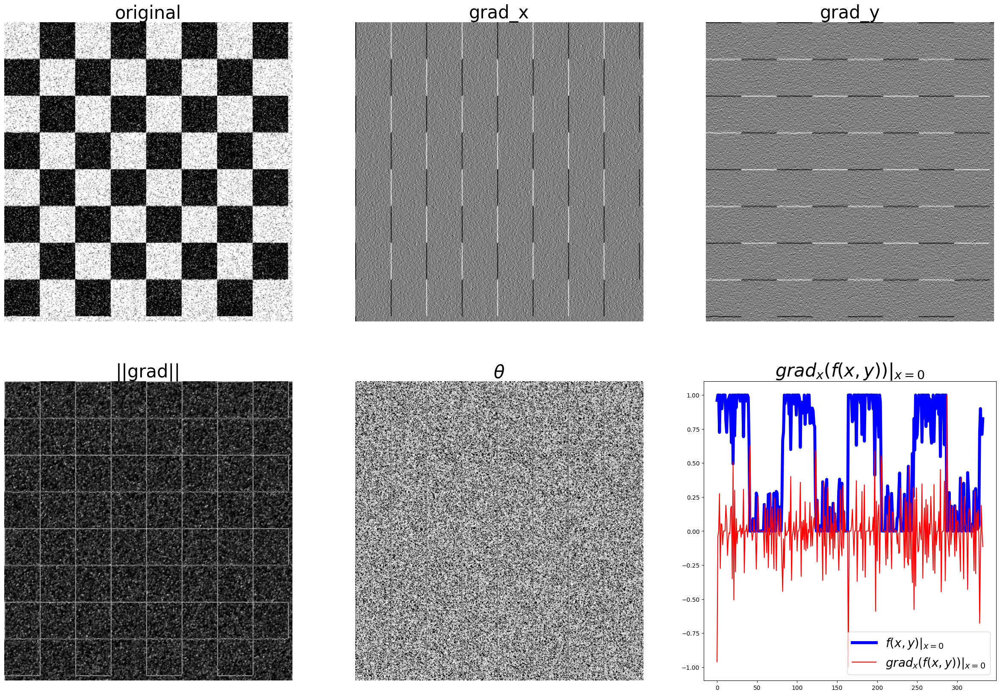

In [86]:
from skimage.util import random_noise
from skimage.filters import gaussian

ker_x = [[-1, 1]]
ker_y = [[-1], [1]]
im = imread('../images/chess.png')
if im.shape[-1] == 4:  
    im = im[..., :3]  
im = rgb2gray(im)

sigma = 0.25
sign = np.random.random(im.shape)
sign[sign <= 0.5] = -1
sign[sign > 0.5] = 1
im = random_noise(im, var=sigma**2)
im = gaussian(im, sigma=0.25)

im_x = signal.convolve2d(im, ker_x, mode='same')
im_y = signal.convolve2d(im, ker_y, mode='same')
im_mag = np.sqrt(im_x**2 + im_y**2)
im_ang = np.arctan(im_y/im_x)
pylab.gray()
pylab.figure(figsize=(30,20))
pylab.subplot(231)
pylab.imshow(im)
pylab.title('original', size=30)
pylab.axis('off')
pylab.subplot(232)
pylab.imshow(im_x)
pylab.title('grad_x', size=30)
pylab.axis('off')
pylab.subplot(233)
pylab.imshow(im_y)
pylab.title('grad_y', size=30)
pylab.axis('off')
pylab.subplot(234)
pylab.imshow(im_mag)
pylab.title('||grad||', size=30)
pylab.axis('off')
pylab.subplot(235)
pylab.imshow(im_ang)
pylab.title(r'$\theta$', size=30)
pylab.axis('off')
pylab.subplot(236)
pylab.plot(range(im.shape[1]), im[0,:], 'b-', label=r'$f(x,y)|_{x=0}$', linewidth=5)
pylab.plot(range(im.shape[1]), im_x[0,:], 'r-', label=r'$grad_x (f(x,y))|_{x=0}$')
pylab.title(r'$grad_x (f(x,y))|_{x=0}$', size=30)
pylab.legend(prop={'size': 20})
pylab.show()

### Làm nét với Laplacian

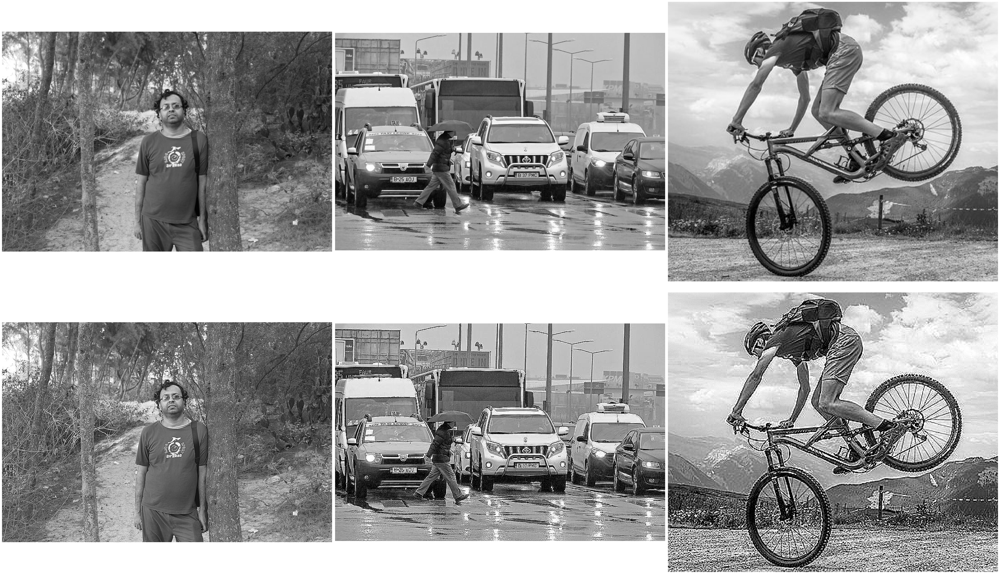

In [87]:
from skimage.filters import laplace

# Mở các bức ảnh từ đường dẫn đã chỉ định
img = rgb2gray(np.array(Image.open('../images/me8.jpg')))
img1 = rgb2gray(np.array(Image.open('../images/cars.jpg')))
img2 = rgb2gray(np.array(Image.open('../images/cycle.jpg')))

# Tạo danh sách chứa các bức ảnh gốc và danh sách ảnh đã làm sắc nét
list_img = [img, img1, img2]
list_img_sharpened = [np.clip(laplace(im) + im, 0, 1) for im in list_img]

# Tạo cửa sổ hiển thị với kích thước lớn
pylab.figure(figsize=(50, 30))

for i in range(3):
    pylab.subplot(2, 3, i + 1)
    pylab.imshow(list_img[i], cmap='gray')
    pylab.axis('off')
    
    pylab.subplot(2, 3, i + 4)
    pylab.imshow(list_img_sharpened[i], cmap='gray')
    pylab.axis('off')

pylab.tight_layout()
pylab.show()

### Phát hiện biên sử dụng bộ lọc Sobel

<Figure size 640x480 with 0 Axes>

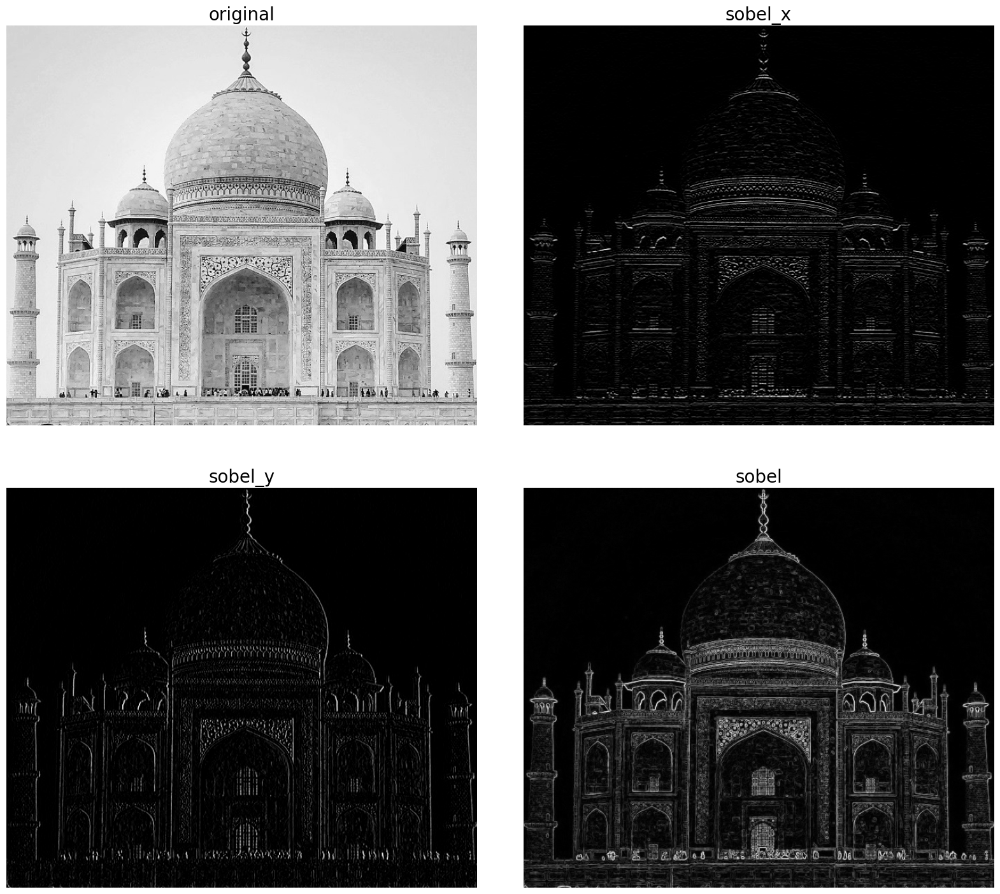

In [88]:
im = rgb2gray(imread('../images/tajmahal1.jpg')) # RGB image to gray scale
pylab.gray() 
pylab.figure(figsize=(20,18))
pylab.subplot(2,2,1)
plot_image(im, 'original')
pylab.subplot(2,2,2)
edges_x = filters.sobel_h(im)
plot_image(np.clip(edges_x,0,1), 'sobel_x')
pylab.subplot(2,2,3)
edges_y = filters.sobel_v(im)
plot_image(np.clip(edges_y,0,1), 'sobel_y')
pylab.subplot(2,2,4)
edges = filters.sobel(im)
plot_image(np.clip(edges,0,1), 'sobel')
pylab.subplots_adjust(wspace=0.1, hspace=0.1)
pylab.show()

### Phát hiện biên với các bộ lọc Scharr, Prewitt, Roberts, Laplace

<Figure size 640x480 with 0 Axes>

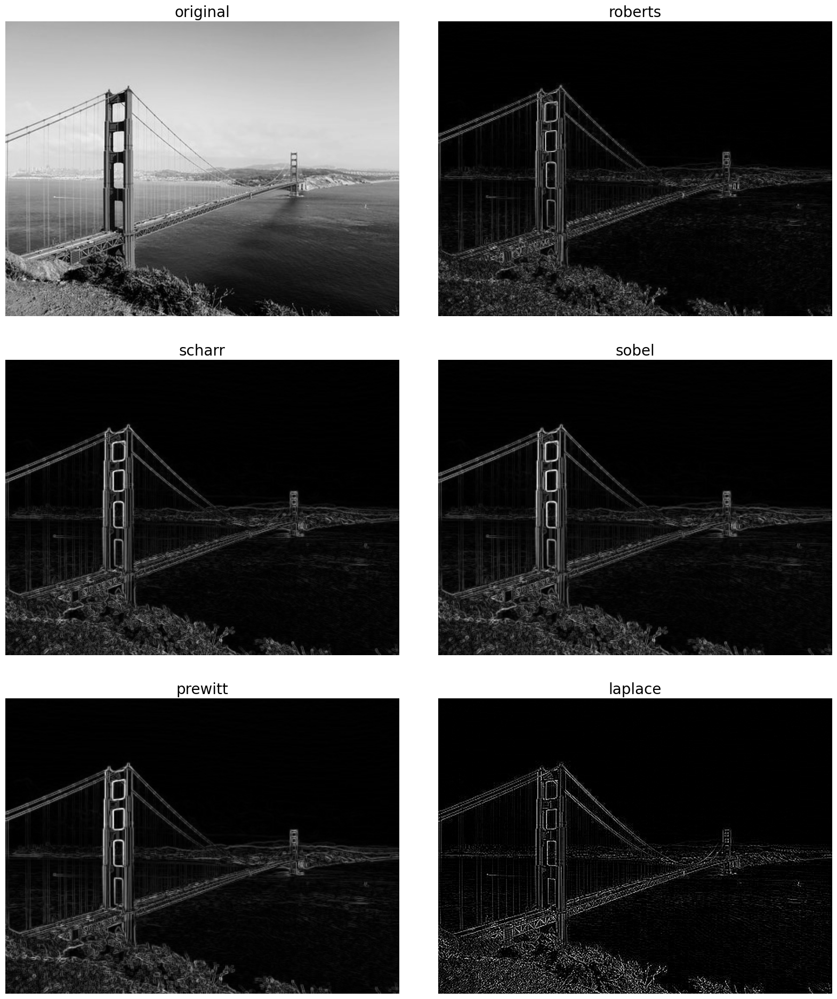

In [89]:
im = rgb2gray(imread('../images/goldengate.jpg')) # RGB image to gray scale
pylab.gray()
pylab.figure(figsize=(20,24))
pylab.subplot(3,2,1), plot_image(im, 'original')
edges = filters.roberts(im)
pylab.subplot(3,2,2), plot_image(edges, 'roberts')
edges = filters.scharr(im)
pylab.subplot(3,2,3), plot_image(edges, 'scharr')
edges = filters.sobel(im)
pylab.subplot(3,2,4), plot_image(edges, 'sobel')
edges = filters.prewitt(im)
pylab.subplot(3,2,5), plot_image(edges, 'prewitt')
edges = np.clip(filters.laplace(im), 0, 1)
pylab.subplot(3,2,6), plot_image(edges, 'laplace')
pylab.subplots_adjust(wspace=0.1, hspace=0.1)
pylab.show()

### Phát hiện biên với phương pháp Canny

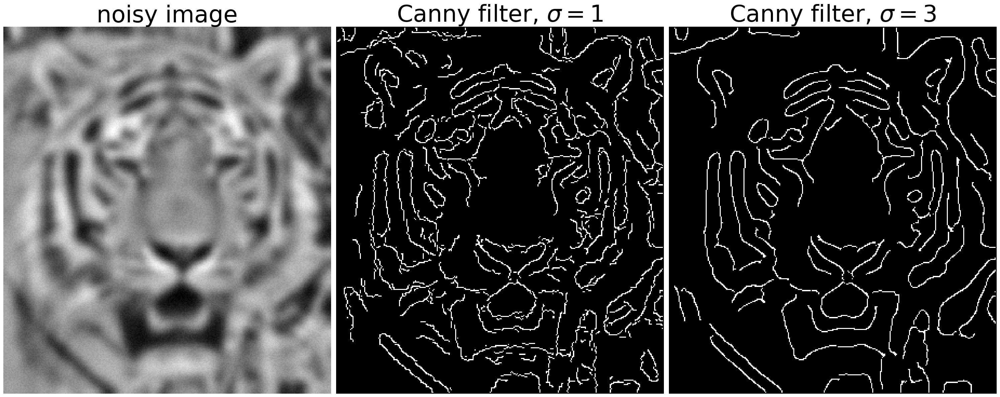

In [90]:
im = rgb2gray(imread('../images/tiger3.jpg'))
im = ndimage.gaussian_filter(im, 4)
im += 0.05 * np.random.random(im.shape)
edges1 = feature.canny(im)
edges2 = feature.canny(im, sigma=2)
fig, (axes1, axes2, axes3) = pylab.subplots(nrows=1, ncols=3, figsize=(30,
12), sharex=True, sharey=True)
axes1.imshow(im, cmap=pylab.cm.gray), axes1.axis('off'),
axes1.set_title('noisy image', fontsize=50)
axes2.imshow(edges1, cmap=pylab.cm.gray), axes2.axis('off')
axes2.set_title('Canny filter, $\sigma=1$', fontsize=50)
axes3.imshow(edges2, cmap=pylab.cm.gray), axes3.axis('off')
axes3.set_title('Canny filter, $\sigma=3$', fontsize=50)
fig.tight_layout()
pylab.show()

### Bộ lọc LoG

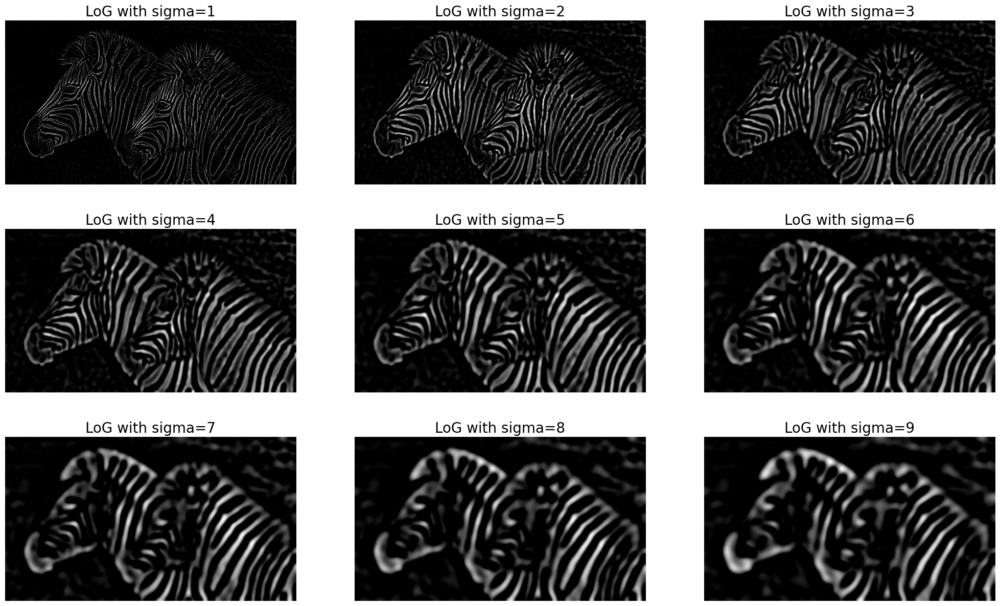

In [91]:
img = rgb2gray(imread('../images/zebras.jpg')) 
fig = pylab.figure(figsize=(25,15))
pylab.gray() # show the filtered result in grayscale
for sigma in range(1,10):
    pylab.subplot(3,3,sigma)
    img_log = ndimage.gaussian_laplace(img, sigma=sigma)
    pylab.imshow(np.clip(img_log,0,1)), pylab.axis('off')
    pylab.title('LoG with sigma=' + str(sigma), size=20)
pylab.show()

### Phát hiện biên với bộ lọc LoG

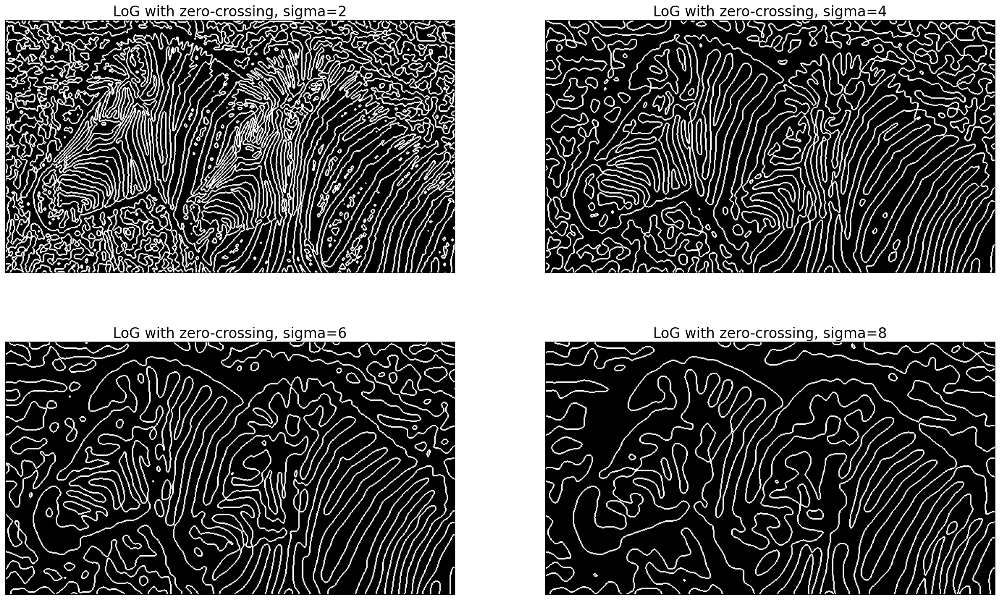

In [92]:
def zero_crossing(img): 
    """Tìm các điểm zero-crossing trong ảnh đầu vào"""
    zero_cross = np.zeros_like(img)  # Tạo ảnh nhị phân với 0 là giá trị mặc định

    for i in range(1, img.shape[0]-1):     # Lặp qua các pixel (trừ biên)
        for j in range(1, img.shape[1]-1):
            # Kiểm tra dấu của các điểm lân cận
            current_pixel = img[i, j]
            neighbors = [img[i-1, j], img[i+1, j], img[i, j-1], img[i, j+1]]

            if current_pixel > 0 and any(neighbor < 0 for neighbor in neighbors):
                zero_cross[i, j] = 1
            elif current_pixel < 0 and any(neighbor > 0 for neighbor in neighbors):
                zero_cross[i, j] = 1

    return zero_cross

img = rgb2gray(imread('../images/zebras.jpg'))
img = img_as_float(img)  # Chuyển ảnh về dạng float

fig = pylab.figure(figsize=(25, 15))
pylab.gray()  # Hiển thị ảnh đã lọc dưới dạng grayscale

# Vòng lặp qua các giá trị sigma
for sigma in range(2, 10, 2):
    pylab.subplot(2, 2, sigma // 2)  # Đảm bảo index là số nguyên
    result = ndimage.gaussian_laplace(img, sigma=sigma)
    pylab.imshow(zero_crossing(result))  # Hiển thị kết quả zero-crossing
    pylab.axis('off')
    pylab.title('LoG with zero-crossing, sigma=' + str(sigma), size=20)

pylab.show()